In [1]:
from pathlib import Path
import torch
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from matplotlib.font_manager import FontProperties, fontManager
from d3s.datasets import D3S, ImageNet, ImageNetC
import json
from collections import defaultdict, OrderedDict
import numpy as np
from itertools import product
import lpips
from tqdm import trange, tqdm
import torchvision.transforms as T
from torch.utils.data import DataLoader, Subset
from PIL import Image

In [2]:
font_path = "/cmlscratch/pkattaki/void/d3s/d3s/assets/Roboto-Regular.ttf"
fontManager.addfont(font_path)
prop = FontProperties(fname=font_path, weight="regular")
sns.set(font=prop.get_name())

In [3]:
plots_folder = Path("/cmlscratch/pkattaki/void/d3s/d3s/outputs/plots")

In [12]:
d3s = D3S("/cmlscratch/pkattaki/datasets/d3s", split="train")

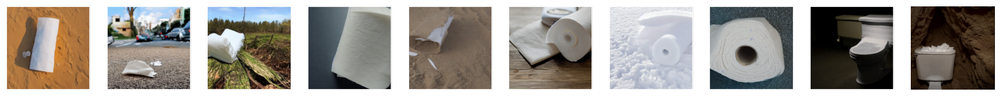

In [153]:
class_idx = 999
images = []
num_backgrounds = len(d3s.backgrounds)
_, axs = plt.subplots(1, num_backgrounds, figsize=(20, 50))
for bg_idx in range(num_backgrounds):
    image, _, _ = d3s.get_random(class_idx=class_idx, bg_idx=bg_idx, num_samples=1)[0]
    axs[bg_idx].imshow(image)
    axs[bg_idx].get_xaxis().set_ticks([])
    axs[bg_idx].get_yaxis().set_ticks([])
    images.append(image)
plt.axis("off")
plt.show()

In [6]:
from copy import deepcopy
black_swan_100 = deepcopy(images)

In [36]:
television_851 = deepcopy(images)

In [31]:
station_wagon_436 = deepcopy(images)

In [156]:
toilet_paper_999 = deepcopy(images)

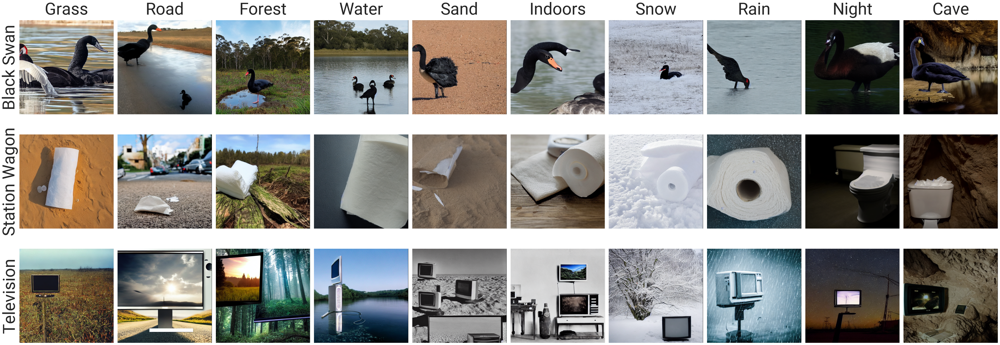

In [157]:
_, axs = plt.subplots(3, num_backgrounds, figsize=(50, 18))
for bg_idx in range(num_backgrounds):
    axs[0, bg_idx].imshow(black_swan_100[bg_idx])
    axs[0, bg_idx].get_xaxis().set_ticks([])
    axs[0, bg_idx].get_yaxis().set_ticks([])
    axs[0, bg_idx].set_title(d3s.backgrounds[bg_idx].capitalize(), fontdict={"fontsize":60}, pad=20)
for bg_idx in range(num_backgrounds):
    axs[1, bg_idx].imshow(toilet_paper_999[bg_idx])
    axs[1, bg_idx].get_xaxis().set_ticks([])
    axs[1, bg_idx].get_yaxis().set_ticks([])
for bg_idx in range(num_backgrounds):
    axs[2, bg_idx].imshow(television_851[bg_idx])
    axs[2, bg_idx].get_xaxis().set_ticks([])
    axs[2, bg_idx].get_yaxis().set_ticks([])
axs[0, 0].set_ylabel("Black Swan", fontdict={"fontsize":60})
axs[1, 0].set_ylabel("Station Wagon", fontdict={"fontsize":60})
axs[2, 0].set_ylabel("Television", fontdict={"fontsize":60})
plt.tight_layout()
plt.subplots_adjust(hspace=0)
plt.savefig(plots_folder / "d3s_samples.pdf", bbox_inches="tight")

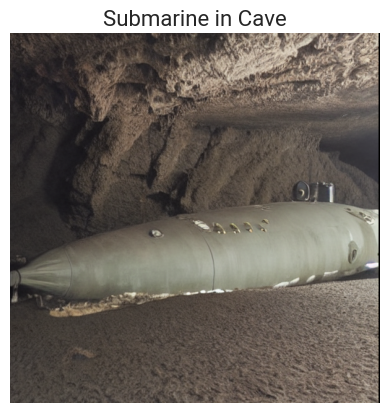

In [236]:
class_idx = 833
bg_idx = 9
if bg_idx == 5:
    prep = ""
elif bg_idx == 8:
    prep = "at"
elif bg_idx == 1 or bg_idx == 0:
    prep = "on"
else:
    prep = "in"
image, _, _ = d3s.get_random(class_idx=class_idx, bg_idx=bg_idx, num_samples=1)[0]
plt.imshow(image)
plt.title(f"{d3s.classes[class_idx].capitalize()} {prep} {d3s.backgrounds[bg_idx].capitalize()}", fontdict={"fontsize":16})
plt.axis("off")
plt.savefig(plots_folder / "sss" / f"{class_idx}_{bg_idx}.png", bbox_inches="tight")

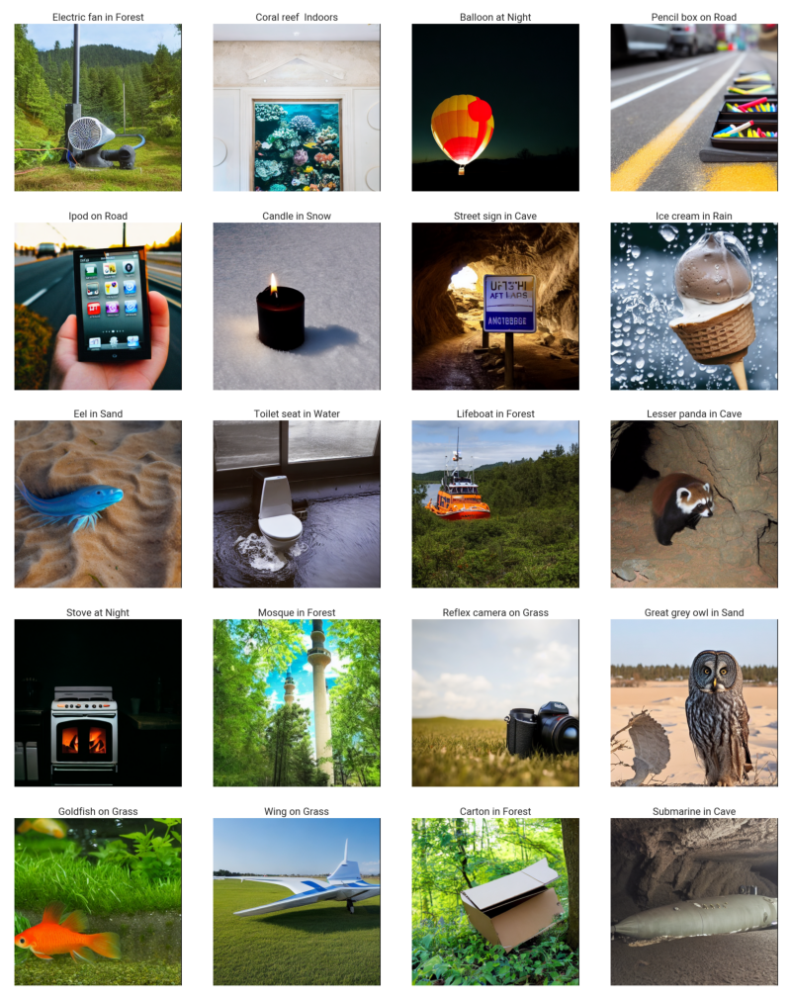

In [240]:
from PIL import Image
fig, ax = plt.subplots(5, 4, figsize=(8, 10), constrained_layout=True)
images = plots_folder.glob("sss/*.png")
images = [Image.open(image) for image in images]
idx = 0
for i in range(5):
    for j in range(4):
        ax[i, j].imshow(images[idx])
        ax[i, j].axis("off")
        idx += 1
plt.savefig(plots_folder / "d3s-more-surprising.png", bbox_inches="tight")

In [4]:
TYPE = "type"
EXTRA_DATA = "extra_data"
ADV = "2_adv"
CLIP = "5_clip"
CNN = "0_cnn"
TRANSFORMER = "1_transformer"
SELF_SUP = "4_self_sup"
SEMI_SUP = "3_semi_sup"

models = {
    "resnet50": {TYPE: CNN, EXTRA_DATA: False},
    "resnext50_32x4d": {TYPE: CNN, EXTRA_DATA: False},
    "densenet121": {TYPE: CNN, EXTRA_DATA: False},
    "efficientnet_b0": {TYPE: CNN, EXTRA_DATA: False},
    "vit_base_patch16_224": {TYPE: TRANSFORMER, EXTRA_DATA: False},
    "vit_large_patch32_384": {TYPE: TRANSFORMER, EXTRA_DATA: False},
    "vit_base_patch16_224_sam": {TYPE: TRANSFORMER, EXTRA_DATA: False},
    "vit_base_patch16_224_miil": {TYPE: TRANSFORMER, EXTRA_DATA: True},
    "inception_resnet_v2": {TYPE: CNN, EXTRA_DATA: False},
    "mobilenetv3_small_100": {TYPE: CNN, EXTRA_DATA: False},
    "mobilenetv2_140": {TYPE: CNN, EXTRA_DATA: False},
    "resnetv2_101x3_bitm": {
        TYPE: CNN,
        EXTRA_DATA: True,
    },
    "resnetv2_50x1_bit_distilled": {
        TYPE: CNN,
        EXTRA_DATA: True,
    },
    "ssl_resnet50": {
        TYPE: SEMI_SUP,
        EXTRA_DATA: True,
    },
    "ssl_resnext50_32x4d": {
        TYPE: SEMI_SUP,
        EXTRA_DATA: True,
    },
    "swsl_resnet50": {
        TYPE: SEMI_SUP,
        EXTRA_DATA: True,
    },
    "swsl_resnext50_32x4d": {
        TYPE: SEMI_SUP,
        EXTRA_DATA: True,
    },
    "adv_inception_v3": {
        TYPE: ADV,
        EXTRA_DATA: False,
    },
    "ens_adv_inception_resnet_v2": {
        TYPE: ADV,
        EXTRA_DATA: False,
    },
    "dino_vitb8": {TYPE: SELF_SUP, EXTRA_DATA: False},
    "dino_resnet50": {TYPE: SELF_SUP, EXTRA_DATA: False},
    "beit_base_patch16_224": {TYPE: SELF_SUP, EXTRA_DATA: False},
    "beit_large_patch16_512": {TYPE: SELF_SUP, EXTRA_DATA: False},
    "beitv2_large_patch16_224": {TYPE: SELF_SUP, EXTRA_DATA: False},
    "deit_base_patch16_384": {TYPE: TRANSFORMER, EXTRA_DATA: False},
    "deit3_huge_patch14_224": {TYPE: TRANSFORMER, EXTRA_DATA: False},
    "deit3_huge_patch14_224_in21ft1k": {
        TYPE: TRANSFORMER,
        EXTRA_DATA: True,
    },
    "clip-RN50": {TYPE: CLIP, EXTRA_DATA: True},
    "clip-RN50x64": {TYPE: CLIP, EXTRA_DATA: True},
    "clip-ViT-B/32": {TYPE: CLIP, EXTRA_DATA: True},
    "clip-ViT-L/14@336px": {TYPE: CLIP, EXTRA_DATA: True},
    "robust_resnet50_l2": {TYPE: ADV, EXTRA_DATA: False},
    "robust_resnet50_linf": {TYPE: ADV, EXTRA_DATA: False},
}


In [5]:
d3s_eval_stats_folder = Path("/cmlscratch/pkattaki/void/d3s/d3s/outputs/d3s_eval_stats")
d3s_eval_stats = OrderedDict()
for model_stats_path in d3s_eval_stats_folder.glob("*.pt"):
    model_name = model_stats_path.stem
    if model_name.startswith("clip-ViT"):
        model_name = model_name[:10] + "/" + model_name[11:]
    d3s_eval_stats[model_name] = torch.load(model_stats_path)
print(f"Found stats for {len(d3s_eval_stats)} models")

Found stats for 33 models


In [6]:
NAME = "model_name"
GAP = "generalization_gap"
TYPE_LABEL = "type_label"
type_labels = {
    CNN: "CNN",
    TRANSFORMER: "Transformer",
    ADV: "Adversarially Trained",
    SEMI_SUP: "Semi-Supervised",
    SELF_SUP: "Self-Supervised",
    CLIP: u"CLIP $^\u2021$ (Zero Shot)"
}

In [7]:
top1_accuracies_df = pd.DataFrame.from_dict({NAME: list(d3s_eval_stats.keys())})
top1_accuracies_df["imagenet_top1"] = [stats["imagenet_top1"] for _, stats in d3s_eval_stats.items()]
top1_accuracies_df["d3s_top1"] = [stats["d3s_top1"] for _, stats in d3s_eval_stats.items()]
top1_accuracies_df[TYPE] = [models[m][TYPE] for m in top1_accuracies_df[NAME]]
top1_accuracies_df[TYPE_LABEL] = [type_labels[t] for t in top1_accuracies_df[TYPE]]
# {name: (stats["imagenet_top1"], stats["d3s_top1"]) for name, stats in d3s_eval_stats.items()}
top1_accuracies_df.head()

,model_name,imagenet_top1,d3s_top1,type,type_label
0,vit_base_patch16_224,84.536,71.297436,1_transformer,Transformer
1,deit3_huge_patch14_224_in21ft1k,87.192,72.579201,1_transformer,Transformer
2,deit_base_patch16_384,83.102,65.638643,1_transformer,Transformer
3,vit_base_patch16_224_miil,84.272,68.336505,1_transformer,Transformer
4,clip-ViT-L/14@336px,71.840,75.814396,5_clip,CLIP $^‡$ (Zero Shot)


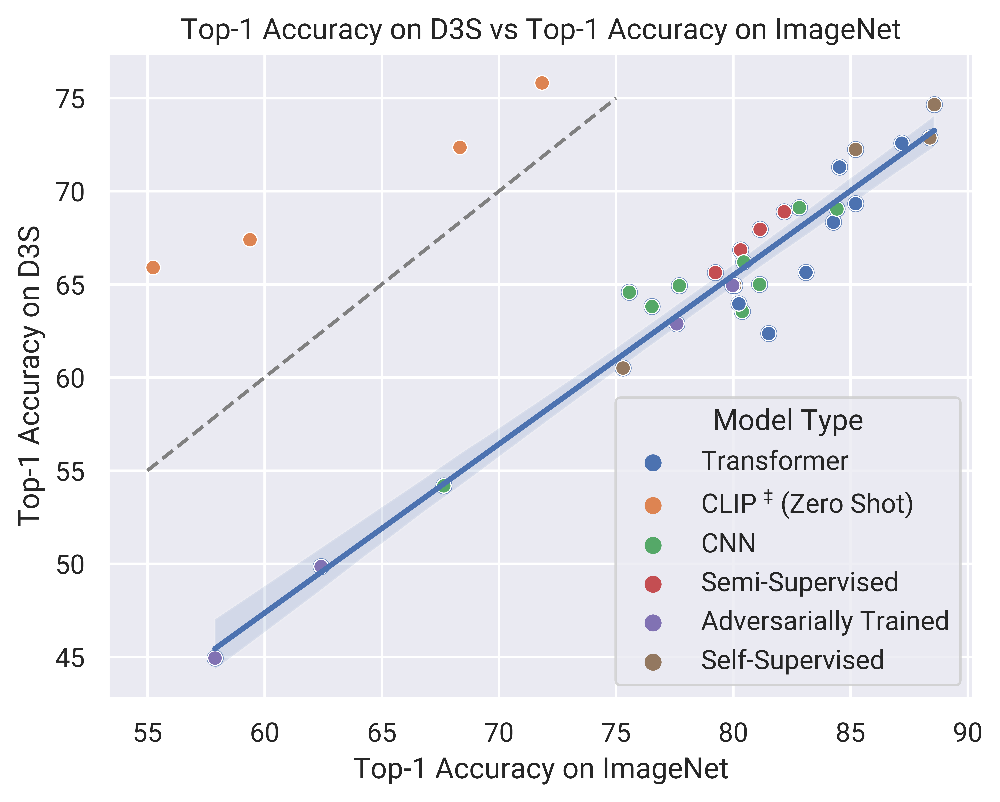

In [8]:
fig = plt.figure(dpi=1200)
eq_data = np.linspace(55, 75, num=10)
eq_df = pd.DataFrame({"x": eq_data, "y": eq_data})
sns.lineplot(eq_df, x="x", y="y", linestyle="--", color="gray")
sns.regplot(top1_accuracies_df.loc[top1_accuracies_df["type"] != "5_clip"], x="imagenet_top1", y="d3s_top1")
ax = sns.scatterplot(top1_accuracies_df, x="imagenet_top1", y="d3s_top1", hue=TYPE_LABEL)


ax.get_legend().set_title("Model Type")
ax.set_xlabel("Top-1 Accuracy on ImageNet")
ax.set_ylabel("Top-1 Accuracy on D3S")
ax.set_title("Top-1 Accuracy on D3S vs Top-1 Accuracy on ImageNet")
plt.savefig(plots_folder / "accuracies_scatter.pdf")

## Generalization Gap

In [6]:
def compute_generalization_gap(stats):
    imagenet_top1 = stats["imagenet_top1"]
    d3s_top1 = stats["d3s_top1"]
    return imagenet_top1 - d3s_top1

In [9]:


generalization_gaps = {name: compute_generalization_gap(stats) for name, stats in d3s_eval_stats.items()}
generalization_gaps_df = pd.DataFrame.from_dict(generalization_gaps, orient="index", columns=[GAP])
generalization_gaps_df[TYPE] = [models[m][TYPE] for m in generalization_gaps_df.index]
generalization_gaps_df[TYPE_LABEL] = [type_labels[t] for t in generalization_gaps_df[TYPE]]
generalization_gaps_df[EXTRA_DATA] = [models[m][EXTRA_DATA] for m in generalization_gaps_df.index]
generalization_gaps_df.reset_index(inplace=True)
generalization_gaps_df = generalization_gaps_df.rename(columns={"index": NAME})
generalization_gaps_df = generalization_gaps_df.sort_values(by=[TYPE, NAME])
generalization_gaps_df.head()

,model_name,generalization_gap,type,type_label,extra_data
29,densenet121,10.988829,0_cnn,CNN,False
9,efficientnet_b0,12.770204,0_cnn,CNN,False
17,inception_resnet_v2,14.249634,0_cnn,CNN,False
8,mobilenetv2_140,12.721649,0_cnn,CNN,False
12,mobilenetv3_small_100,13.466874,0_cnn,CNN,False


In [11]:
fig = plt.figure(dpi=1200)
fig.set_figwidth(12)
ax = sns.barplot(generalization_gaps_df, x=NAME, y=GAP, hue=TYPE_LABEL, dodge=False)
ax.set_xlabel("Model Architecture")
ax.set_ylabel("Drop in Top-1 Accuracy")
ax.set_title("Robustness on the D3S Benchmark")
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

# hack to hatch bars for models with extra data
containers = list(ax.containers)
for row_idx, row in enumerate(generalization_gaps_df.itertuples()):
    is_extra_data = row[row._fields.index(EXTRA_DATA)]
    if is_extra_data:
        model_type = row[row._fields.index(TYPE)]
        bars = list(containers[int(model_type[0])])
        bars[row_idx].set_hatch("//")
        
ax.get_legend().set_title("")
plt.xticks(rotation=90, fontsize=6)
plt.tight_layout()
plt.savefig(plots_folder / "generalization_gap.pdf")

In [23]:
mean_generalization_gaps_df = generalization_gaps_df.groupby(TYPE_LABEL).mean()
mean_generalization_gaps_df[TYPE_LABEL] = mean_generalization_gaps_df.index
mean_generalization_gaps_df[TYPE] = [ADV, CLIP, CNN, SELF_SUP, SEMI_SUP, TRANSFORMER]
mean_generalization_gaps_df = mean_generalization_gaps_df.sort_values(by=[TYPE])
mean_generalization_gaps_df.head()

,generalization_gap,extra_data,type_label,type
type_label,,,,
CNN,14.025942,0.222222,CNN,0_cnn
Transformer,16.082694,0.285714,Transformer,1_transformer
Adversarially Trained,13.815603,0.000000,Adversarially Trained,2_adv
Semi-Supervised,13.383797,1.000000,Semi-Supervised,3_semi_sup
Self-Supervised,14.468884,0.000000,Self-Supervised,4_self_sup


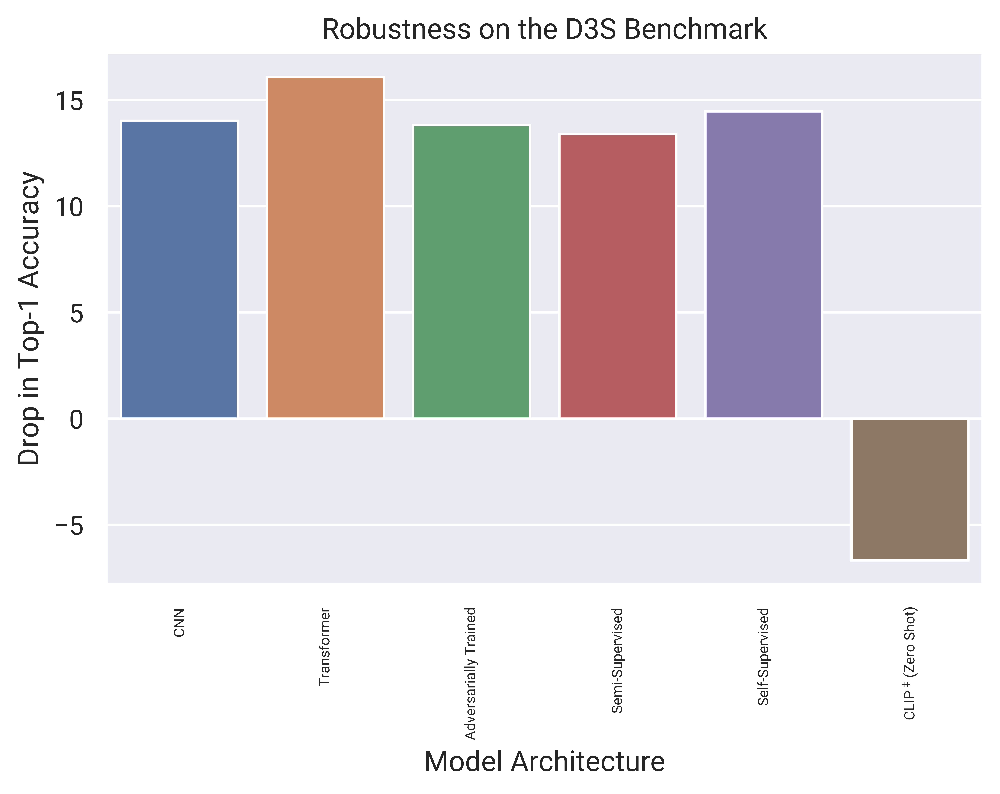

In [24]:
fig = plt.figure(dpi=1200)
fig.set_figwidth(6)
ax = sns.barplot(mean_generalization_gaps_df, x=TYPE_LABEL, y=GAP, dodge=False)
ax.set_xlabel("Model Architecture")
ax.set_ylabel("Drop in Top-1 Accuracy")
ax.set_title("Robustness on the D3S Benchmark")
plt.xticks(rotation=90, fontsize=6)
plt.tight_layout()
plt.savefig(plots_folder / "mean_generalization_gap.pdf")

## Foreground vs. Background

In [7]:
def compute_fg_bg_accuracy(stats):
    d3s_stats = stats["d3s_stats"]
    correct = torch.cat((d3s_stats[0], d3s_stats[0].sum(dim=-1, keepdim=True)), dim=-1)
    total = torch.cat((d3s_stats[2], d3s_stats[2].sum(dim=-1, keepdim=True)), dim=-1)
    return 100 * correct / (1e-8 + total)
d3s_val = D3S("/cmlscratch/pkattaki/datasets/d3s", split="val")

In [8]:
COARSE_LABEL = "coarse_label"
coarse_labels = {
    0: "Dog",
    1: "Bird",
    2: "Vehicle",
    3: "Reptile",
    4: "Carnivore",
    5: "Insect",
    6: "Instrument",
    7: "Primate",
    8: "Fish",
    -1: "Miscellaneous"
}
with open("/cmlscratch/pkattaki/void/d3s/d3s/assets/in_to_in9.json", "r") as f:
    in_to_in9 = json.load(f)
    imagenet_to_coarse_label = {int(k): coarse_labels[v] for k, v in in_to_in9.items()}
    coarse_label_to_imagenet = defaultdict(list)
    for k, v in imagenet_to_coarse_label.items():
        coarse_label_to_imagenet[v].append(k)

In [9]:
fg_bg_accuracies_unreduced = torch.stack([compute_fg_bg_accuracy(stats) for stats in d3s_eval_stats.values()]).numpy()
fg_bg_accuracies = np.mean(fg_bg_accuracies_unreduced, axis=0)
fg_bg_accuracies_df = pd.DataFrame.from_records(fg_bg_accuracies)
fg_bg_accuracies_df.columns = d3s_val.backgrounds + ["all"]
fg_bg_accuracies_df[COARSE_LABEL] = [imagenet_to_coarse_label[idx] for idx in fg_bg_accuracies_df.index]
fg_bg_accuracies_df.head()

,grass,road,forest,water,sand,indoors,snow,rain,night,cave,all,coarse_label
0,0.000000,77.272728,21.212122,86.868690,67.676765,75.757576,65.151512,44.696968,64.393936,0.000000,64.090912,Fish
1,100.000000,99.242424,0.000000,96.969696,86.868683,98.989891,98.484848,0.000000,95.454544,100.000000,96.515152,Fish
2,81.818184,80.808090,63.636364,86.868698,100.000000,78.181816,90.909088,89.393936,84.848488,57.575756,80.454544,Fish
3,57.575756,74.242424,87.878784,56.060608,58.585861,90.909088,78.787880,57.575756,95.959595,89.898994,76.714516,Fish
4,75.757576,9.090909,12.121212,44.696968,72.727272,33.939392,0.000000,54.545456,54.545456,42.424244,40.106953,Fish


In [68]:
fg_bg_accuracies_unreduced.shape

(33, 1000, 11)

In [10]:
def gather_fg_bg(fg, bg):
    bg_idx = d3s_val.backgrounds.index(bg)
    gathered = fg_bg_accuracies_unreduced[:, coarse_label_to_imagenet[fg], bg_idx]
    return np.mean(gathered, axis=-1)

In [11]:
fg_bg_robustness = []
for fg, bg in product(coarse_label_to_imagenet.keys(), d3s_val.backgrounds):
    robustness = gather_fg_bg(fg, bg).mean() - fg_bg_accuracies_unreduced[:, coarse_label_to_imagenet[fg], :-1].mean()
    fg_bg_robustness.append((robustness, fg, bg))
fg_bg_robustness.sort(key=lambda x: x[0])
worst_robust_pairs = [(fg, bg) for _, fg, bg in fg_bg_robustness[:3]] 
best_robust_pairs = [(fg, bg) for _, fg, bg in fg_bg_robustness[-3:]]
print(f"Worst: {fg_bg_robustness[:3]}")
print(f"Best: {fg_bg_robustness[-3:]}")

Worst: [(-14.807823, 'Vehicle', 'snow'), (-13.207226, 'Carnivore', 'sand'), (-11.677639, 'Carnivore', 'night')]
Best: [(10.935928, 'Fish', 'water'), (12.381279, 'Primate', 'sand'), (15.299923, 'Instrument', 'night')]


In [12]:
fg_bg_robustness

[(-14.807823, 'Vehicle', 'snow'),
 (-13.207226, 'Carnivore', 'sand'),
 (-11.677639, 'Carnivore', 'night'),
 (-9.300539, 'Primate', 'forest'),
 (-8.899021, 'Primate', 'water'),
 (-8.647411, 'Vehicle', 'water'),
 (-7.451069, 'Fish', 'indoors'),
 (-6.9001656, 'Insect', 'grass'),
 (-6.8640213, 'Instrument', 'sand'),
 (-6.4658127, 'Instrument', 'forest'),
 (-5.300312, 'Instrument', 'road'),
 (-5.2045784, 'Primate', 'night'),
 (-5.0428963, 'Miscellaneous', 'road'),
 (-4.9763184, 'Fish', 'grass'),
 (-4.9593964, 'Bird', 'snow'),
 (-4.643738, 'Bird', 'night'),
 (-4.639862, 'Instrument', 'snow'),
 (-4.425209, 'Bird', 'cave'),
 (-4.373417, 'Fish', 'sand'),
 (-4.2813835, 'Insect', 'forest'),
 (-4.094673, 'Carnivore', 'indoors'),
 (-4.036915, 'Dog', 'snow'),
 (-3.7989197, 'Fish', 'snow'),
 (-3.6079826, 'Insect', 'road'),
 (-3.402134, 'Reptile', 'sand'),
 (-3.3164291, 'Miscellaneous', 'snow'),
 (-3.0374641, 'Insect', 'night'),
 (-2.9845276, 'Fish', 'road'),
 (-2.745922, 'Instrument', 'water'),
 (-2.

In [13]:
fig, axs = plt.subplots(2, 3)
fig.set_figwidth(10)
fig.set_dpi(1200)

eq_data = np.linspace(40, 80, num=10)
eq_df = pd.DataFrame({"x": eq_data, "y": eq_data})

for i, (fg, bg) in enumerate(worst_robust_pairs + best_robust_pairs):
    df = pd.DataFrame({"d3s_top1": fg_bg_accuracies_unreduced[:, coarse_label_to_imagenet[fg], :-1].mean(axis=(1, 2)), "fg_bg": gather_fg_bg(fg, bg), NAME: models.keys()})
    df[TYPE] = [models[m][TYPE] for m in df[NAME]]
    df[TYPE_LABEL] = [type_labels[t] for t in df[TYPE]]
    
    row_idx = i // 3
    col_idx = i % 3

    sns.scatterplot(df, x="d3s_top1", y="fg_bg", hue=TYPE_LABEL, ax=axs[row_idx][col_idx])
    sns.lineplot(eq_df, x="x", y="y", linestyle="--", color="gray", ax=axs[row_idx][col_idx])
    axs[row_idx][col_idx].get_legend().remove()
    axs[row_idx][col_idx].set_title(f"{fg}, {bg.capitalize()}")
    if row_idx == 1:
        axs[row_idx][col_idx].set_xlabel("Top-1 Accuracy on D3S (FG)")
    else:
        axs[row_idx][col_idx].set_xlabel("")
    if col_idx == 0:
        axs[row_idx][col_idx].set_ylabel("Top-1 Accuracy (FG on BG)")
    else:
        axs[row_idx][col_idx].set_ylabel("")

plt.legend(loc="upper left", bbox_to_anchor=(1, 1))
plt.tight_layout()
plt.savefig(plots_folder / "fg_bg_robustness.pdf")

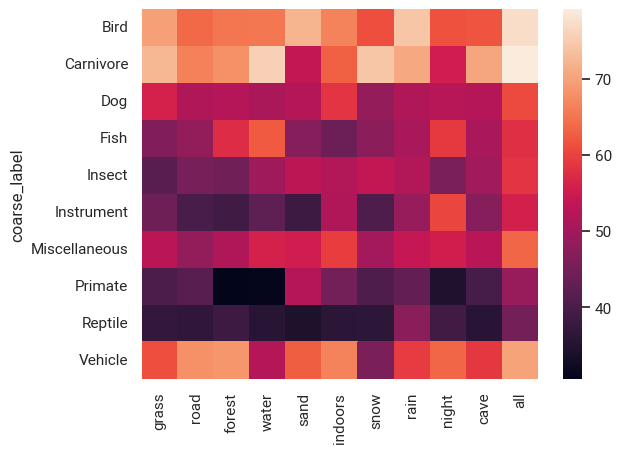

In [18]:
sns.heatmap(fg_bg_accuracies_df.groupby(COARSE_LABEL).mean())

In [30]:
from d3s.pretrained_models import RobustResNet50
import torch.nn as nn
feature_extractor = RobustResNet50("robust_resnet50_l2")
transform = feature_extractor.transform
feature_extractor.eval()
feature_extractor.cuda()
feature_dim = feature_extractor.model.model.fc.in_features
feature_extractor.model.model.fc = nn.Identity()

=> loading checkpoint '/nfshomes/pkattaki/.cache/torch/hub/robustness/robust_resnet_l2_e3.0.pt'
=> loaded checkpoint '/nfshomes/pkattaki/.cache/torch/hub/robustness/robust_resnet_l2_e3.0.pt' (epoch 105)


In [31]:
d3s_train = D3S("/cmlscratch/pkattaki/datasets/d3s", split="train", transform=transform)
imagenet_train = ImageNet(split="train", transform=transform)
imagenet_c = ImageNetC("all", "all", transform=transform)
dataset_names = ["D3S", "ImageNet", "ImageNet-C"]

In [21]:
rng = np.random.default_rng()
num_samples = 50
num_classes = 50
class_idxs = rng.choice(len(imagenet_train.classes), size=num_classes, replace=False)
datasets = [d3s_train, imagenet_train, imagenet_c]
dataset_svals = {}
with torch.no_grad():
    for dataset_name, dataset in zip(dataset_names, datasets):
        features = torch.zeros(num_classes, num_samples, feature_dim).cuda()
        for i, class_idx in enumerate(class_idxs):
            options = dataset.class_to_indices[class_idx]
            samples = [dataset[idx] for idx in rng.choice(options, size=num_samples, replace=False)]
            images = torch.stack([sample[0] for sample in samples]).cuda()
            features[i] = feature_extractor(images)
        dataset_svals[dataset_name] = torch.linalg.svdvals(features).mean(0).cpu().numpy()
        

KeyboardInterrupt: 

In [ ]:
for dataset_name in dataset_names:
    dataset_svals[dataset_name] /= np.linalg.norm(dataset_svals[dataset_name])

In [ ]:
dataset_svals_df = pd.DataFrame.from_dict(dataset_svals)
print(dataset_svals_df.head())
sns.lineplot(data=dataset_svals_df)

In [25]:
rng = np.random.default_rng()

In [ ]:
num_samples = 30
num_classes = 30
class_idxs = rng.choice(len(imagenet_train.classes), num_classes, replace=False)
datasets = [d3s_train, imagenet_train, imagenet_c]
dataset_vars = {dataset_name: np.zeros(num_classes) for dataset_name in dataset_names}
with torch.no_grad():
    for dataset_name, dataset in zip(dataset_names, datasets):
        for i, class_idx in enumerate(tqdm(class_idxs, desc=f"Evaluating on {dataset_name}")):
            options = dataset.class_to_indices[class_idx]
            samples = [dataset[idx] for idx in rng.choice(options, size=num_samples, replace=False)]
            images = torch.stack([sample[0] for sample in samples]).cuda()
            dataset_vars[dataset_name][i] = feature_extractor(images).var(dim=0).mean() 

In [ ]:
dataset_vars_df = pd.DataFrame.from_dict(dataset_vars)
print(dataset_vars_df.head())
sns.lineplot(data=dataset_vars_df)

In [26]:
lpips_transform = T.Compose([
    T.Resize(256),
    T.CenterCrop(224),
    T.ToTensor(),
    T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])
lpips_d3s = D3S("/cmlscratch/pkattaki/datasets/d3s", split="train", transform=lpips_transform)
lpips_imagenet = ImageNet(split="train", transform=lpips_transform)
lpips_imagenet_c = ImageNetC("all", "all", transform=lpips_transform)

In [32]:
lpips_distance = lpips.LPIPS(net="alex").cuda()
num_samples_per_class = 50
num_classes = 50
class_idxs = rng.choice(len(lpips_d3s.classes), num_classes, replace=False)
num_samples = num_samples_per_class * num_classes
distances = defaultdict(list)
mean_distances = {dataset_name: np.zeros(num_classes) for dataset_name in dataset_names}

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/cmlscratch/pkattaki/developer/anaconda3/envs/ldm/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/cmlscratch/pkattaki/developer/anaconda3/envs/ldm/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /cmlscratch/pkattaki/developer/anaconda3/envs/ldm/lib/python3.8/site-packages/lpips/weights/v0.1/alex.pth


In [24]:
for dataset_name, dataset in zip(dataset_names, [lpips_d3s, lpips_imagenet, lpips_imagenet_c]):
    with trange(num_samples) as pbar:
        for i, class_idx in enumerate(class_idxs):
            idxes = dataset.class_to_indices[class_idx]
            pairs = list(product(idxes, repeat=2))
            samples = rng.choice(pairs, size=num_samples_per_class)
            for sample in samples:
                img1, img2 = sample
                img1, img2 = dataset[img1][0].cuda(), dataset[img2][0].cuda()

                distances[class_idx].append(lpips_distance.forward(img1, img2).item())
                pbar.update(1)
            mean_distances[dataset_name][i] = np.mean(np.array(distances[class_idx]))

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/cmlscratch/pkattaki/developer/anaconda3/envs/ldm/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/cmlscratch/pkattaki/developer/anaconda3/envs/ldm/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /cmlscratch/pkattaki/developer/anaconda3/envs/ldm/lib/python3.8/site-packages/lpips/weights/v0.1/alex.pth


100%|███████████████████████████████████████████████████████████████████████████████| 2500/2500 [02:10<00:00, 19.22it/s]


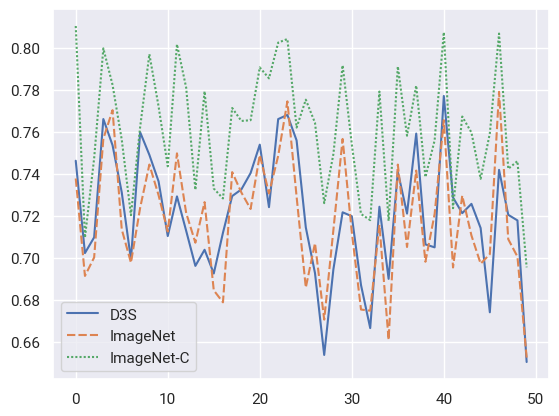

In [25]:
mean_distances_df = pd.DataFrame.from_dict(mean_distances)
sns.lineplot(data=mean_distances_df)

In [33]:
distances = defaultdict(list)
with trange(3 * num_samples) as pbar:
    for i, class_idx in enumerate(class_idxs):
        d3s_idxes = lpips_d3s.class_to_indices[class_idx]
        imagenet_idxes = lpips_imagenet.class_to_indices[class_idx]
        d3s_pairs = list(product(d3s_idxes, repeat=2))
        samples = rng.choice(d3s_pairs, size=num_samples_per_class)
        for sample in samples:
            img1, img2 = sample
            img1, img2 = lpips_d3s[img1][0].cuda(), lpips_d3s[img2][0].cuda()

            distances["Within D3S"].append(lpips_distance.forward(img1, img2).item())
            pbar.update(1)
        imagenet_pairs = list(product(imagenet_idxes, repeat=2))
        samples = rng.choice(imagenet_pairs, size=num_samples_per_class)
        for sample in samples:
            img1, img2 = sample
            img1, img2 = lpips_imagenet[img1][0].cuda(), lpips_imagenet[img2][0].cuda()

            distances["Within ImageNet"].append(lpips_distance.forward(img1, img2).item())
            pbar.update(1)
        cross_pairs = list(product(imagenet_idxes, d3s_idxes))
        samples = rng.choice(cross_pairs, size=num_samples_per_class)
        for sample in samples:
            img1, img2 = sample
            img1, img2 = lpips_imagenet[img1][0].cuda(), lpips_d3s[img2][0].cuda()

            distances["From ImageNet to D3S"].append(lpips_distance.forward(img1, img2).item())
            pbar.update(1)

100%|███████████████████████████████████████████████████████████████████████████████| 7500/7500 [06:39<00:00, 18.75it/s]


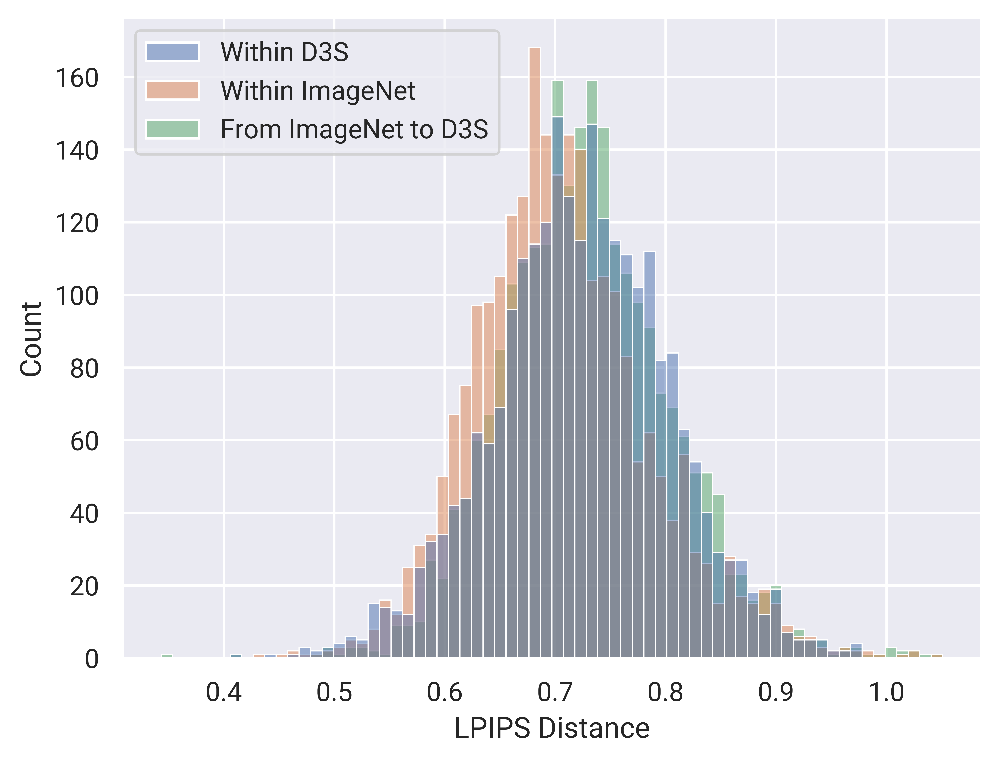

In [34]:
fig = plt.figure(dpi=1200)
distances_df = pd.DataFrame.from_dict(distances)
filtered_df = distances_df.loc[lambda x: (x["Within D3S"] != 0) & (x["Within ImageNet"] != 0)]
# filtered_df = filtered_df.drop("From ImageNet to D3S", axis=1)
sns.histplot(data=filtered_df)
plt.xlabel("LPIPS Distance")
plt.savefig(plots_folder / "lpips.pdf")

In [35]:
for k, v in distances.items():
    print(k, np.mean(v))

Within D3S 0.715543782889843
Within ImageNet 0.7063892322778702
From ImageNet to D3S 0.730092462193966


In [42]:
fig, axs = plt.subplots(10, 3, figsize=(6, 20), constrained_layout=True)
fig.set_dpi(1200)
for i in range(10):
    bg = d3s_val.backgrounds[i]
    for j in range(3):
        image = Image.open(f"/cmlscratch/pkattaki/void/d3s/d3s/images/backgrounds/{bg}/{bg}-{j + 1}.jpeg")
        min_dim = min(image.size)
        image = T.Resize(256)(T.CenterCrop(min_dim)(image))
        axs[i, j].imshow(image)
        axs[i, j].get_xaxis().set_ticks([])
        axs[i, j].get_yaxis().set_ticks([])
    axs[i, 0].set_ylabel(bg.capitalize(), fontdict={"fontsize":20}, rotation=90)
plt.savefig(plots_folder / "backgrounds.pdf")

In [21]:
min(image.size)

802